#HW1 - Data Exploration and Preparation

In [9]:
# This command installs the following library, in case the library is already installed, please comment out the command.
!pip install feature_engine

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from contextlib import contextmanager
import torch
from torch import Tensor
from sklearn.impute import SimpleImputer
from feature_engine.imputation import RandomSampleImputer
from math import floor
plt.rcParams.update({'figure.max_open_warning': 0})

## Loading the dataset

In [11]:
#!rm *.csv

#from google.colab import files
#print("Please load the raw csv data")
#uploadedData = files.upload()
#filename = list(uploadedData)[0]

In [12]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [13]:
dataset = pd.read_csv('/content/drive/MyDrive/Intro to ML - HW1-NEW/virus_data.csv')

## Q1:

In [14]:
dataset.shape

(3000, 29)

## Q2:

In [15]:
dataset['num_of_siblings'].value_counts()

2.0    754
1.0    707
3.0    554
0.0    400
4.0    272
5.0    120
6.0     29
7.0      7
8.0      2
9.0      1
Name: num_of_siblings, dtype: int64


##Q5:

In [16]:
# Selecting samples from the dataset while randomizing the samples
training_data = dataset.sample(frac=0.8, random_state=16)

# Selecting all the samples which are not in training_data
testing_data = dataset.drop(training_data.index)

##Q6:

Before transforming columns into OHE vectors, we would like to impute the missing data (As requested in Q17)

In [17]:
def impute_by_random(df,col_name):
  imputer = RandomSampleImputer(random_state = 16) #as our seed
  imputer.fit(df[col_name].values.reshape(-1,1))
  return imputer.transform(df[col_name].values.reshape(-1,1))

In [18]:
# Transforming blood_type feature into dummy features for OHE but imputing the missing data first:
training_data['blood_type'] = impute_by_random(training_data,'blood_type').values
ohe_blood_type = pd.get_dummies(training_data.blood_type, prefix='blood_type')

##Q7:

In [19]:
# Transform symptoms feature into dummy features
df_symptoms = training_data['symptoms'].str.get_dummies(sep=';').add_prefix('symptoms_')
training_data = pd.concat([training_data, df_symptoms], axis='columns')

##Q8:

In [20]:
# Extract U.S. states (and army region specifiers for military addresses) as features from address 
training_data['address_states'] = training_data['address'].str.slice(start=-8, stop=-6)

# Impute the missing data before transforming into OHE vectors
training_data['address_states'] = impute_by_random(training_data,'address_states').values
df_address_states = training_data.address_states.str.get_dummies().add_prefix('address_')

In [21]:
# Impute missing data & transform the sex feature into dummy feature for OHE
training_data['sex'] = impute_by_random(training_data,'sex').values
ohe_sex = pd.get_dummies(training_data.sex, prefix='sex')
ohe_sex.drop('sex_F', axis='columns', inplace=True)

##Q9:

In [22]:
# First of all, we'll drop the columns which provide zero information:
training_data = training_data.drop(['job','address','current_location','symptoms'], axis='columns')

###  Plotting histograms for all features in dataset

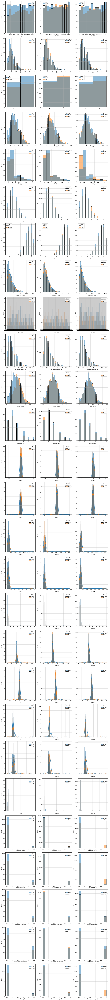

In [23]:
# Plotting histograms for all features in dataset except for states
COL_NAME = list(training_data.columns)
COL_NAME.remove('risk')
COL_NAME.remove('spread')
COL_NAME.remove('covid')
COL_NAME.remove('address_states')
COLS = 3
ROWS = len(COL_NAME)
continuos_cols=['household_income','PCR_01','PCR_02','PCR_03','PCR_04','PCR_06','PCR_07','PCR_08','PCR_09']
plt.figure(figsize=(15, 5 * ROWS))
for i, column in enumerate(COL_NAME):
  kde_val=column in continuos_cols
  plt.subplot(ROWS,COLS,i * 3 + 1)
  sns.histplot(data=training_data, x=column, hue='risk', kde=kde_val,)
  plt.grid(alpha=0.5)
  plt.subplot(ROWS,COLS,i * 3 + 2)
  sns.histplot(data=training_data, x=column, hue='spread', kde=kde_val)
  plt.grid(alpha=0.5)
  plt.subplot(ROWS,COLS,i * 3 + 3)
  sns.histplot(data=training_data, x=column, hue='covid', kde=kde_val)
  plt.grid(alpha=0.5)
plt.tight_layout()

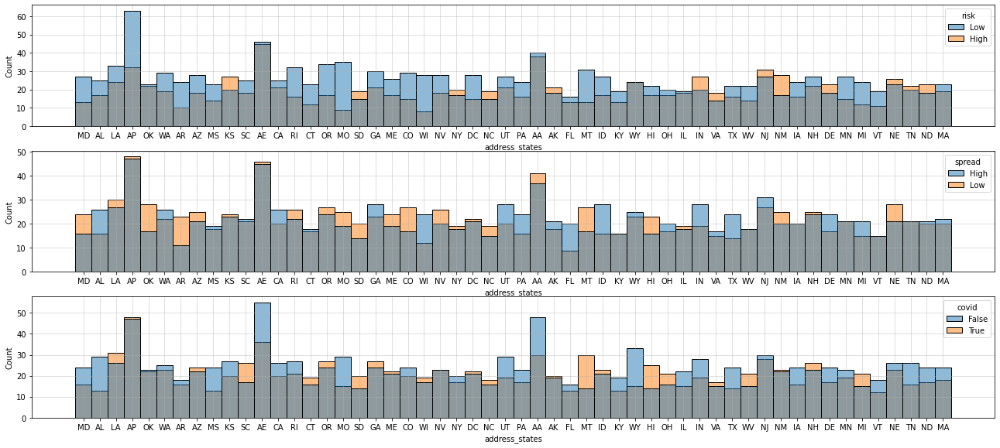

In [24]:
# Seperately plot address_states (because they require wider graphs)
fg, (ax1, ax2, ax3) = plt.subplots(3,1)
fg.set_size_inches(18,8)
fg.tight_layout()
ax1.grid(alpha=0.5)
ax2.grid(alpha=0.5)
ax3.grid(alpha=0.5)
sns.histplot(data=training_data, x='address_states', hue='risk', ax=ax1)
sns.histplot(data=training_data, x='address_states', hue='spread', ax=ax2)
sns.histplot(data=training_data, x='address_states', hue='covid', ax=ax3)


##Q11:

### Graph box plots for household income according to risk levels

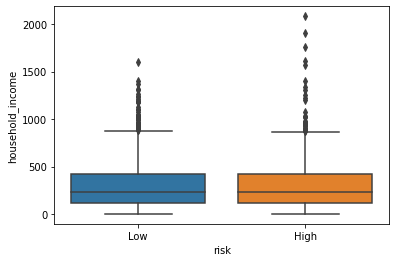

In [25]:
# Graph box plots for household income according to risk levels
sns.boxplot(x='risk', y='household_income', data=training_data)

### Outlier Cleaning

#### Outlier Cleaning Function Definitions

In [26]:
# First we'll find the boundaries according to our distributions:
def normal_boundaries(col : pd.Series):
  max=col.mean()+3*col.std()
  min=col.mean()-3*col.std()
  return (min,max)

def skewed_boundaries(col : pd.Series):
  percentile25 = col.quantile(0.25)
  percentile75 = col.quantile(0.75)
  iqr = percentile75 - percentile25
  max = percentile75 + 1.5 * iqr
  min = percentile25 - 1.5 * iqr
  return (min,max)

def outliers_set_nan_iqr(col):
  lower_limit, upper_limit = skewed_boundaries(col)
  return np.where((col >= upper_limit) | (col <= lower_limit), np.nan, col)

def outliers_set_nan_zscore(col):
  lower_limit, upper_limit = normal_boundaries(col)
  return np.where((col >= upper_limit) | (col <= lower_limit), np.nan, col)


#### Box Plots for Univariate Analysis

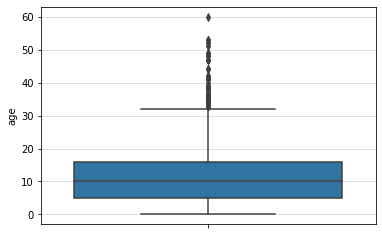

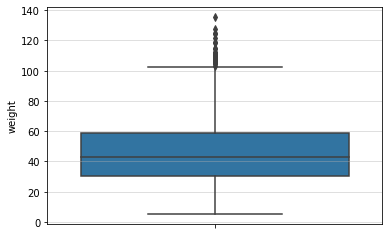

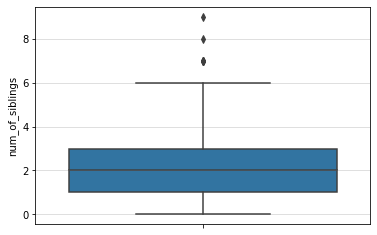

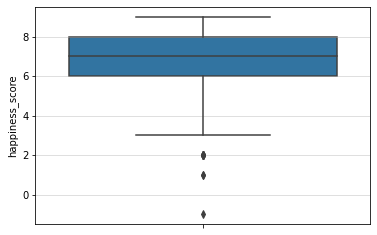

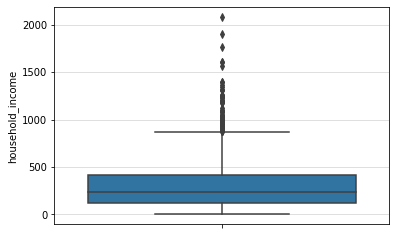

...

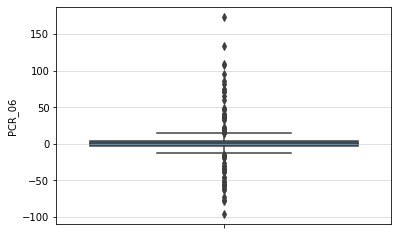

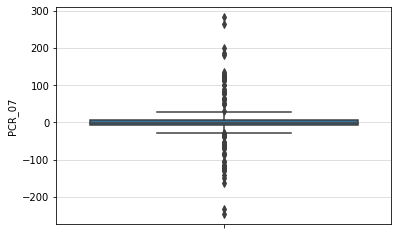

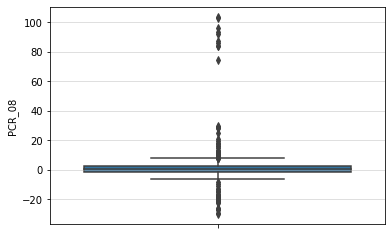

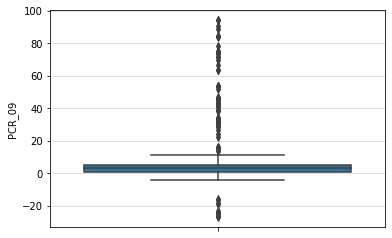

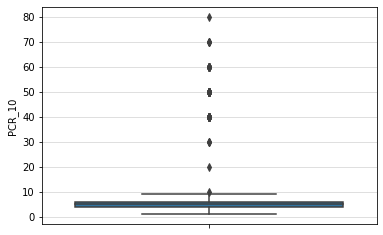

In [27]:
# Plotting box plots for every continuous feature for univariate analysis
num_cols = ['age','weight','num_of_siblings','happiness_score','household_income','conversations_per_day','sugar_levels',\
            'sport_activity','PCR_01','PCR_02','PCR_03','PCR_04','PCR_05','PCR_06','PCR_07','PCR_08','PCR_09','PCR_10']
for col in num_cols:
      plt.figure()
      plt.grid(alpha=0.5)
      sns.boxplot(y=col, data=training_data)

#### Global Outlier Cleaning

In [28]:
# clean univariate outliers by replacing with NaN value according to IQR for non normal distributed features:

n_dist_features = ['PCR_01', 'PCR_02', 'PCR_07']
for col in [x for x in num_cols if x not in n_dist_features]:
#for col in num_cols:
  training_data[col] = outliers_set_nan_iqr(training_data[col])

# clean univariate outliers by replacing with NaN value according to z-score for normal distributed features:
for col in n_dist_features:
  training_data[col] = outliers_set_nan_zscore(training_data[col])

#### Scatter Plots For Bivariate Analysis

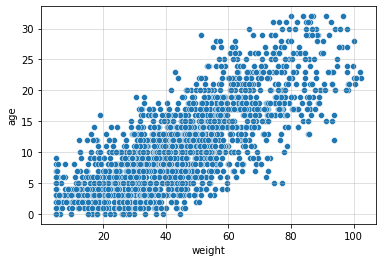

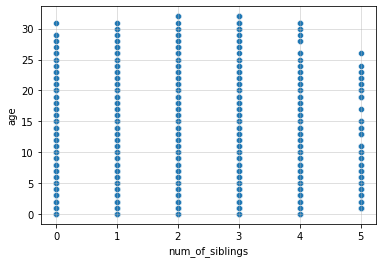

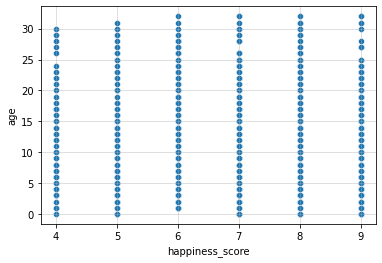

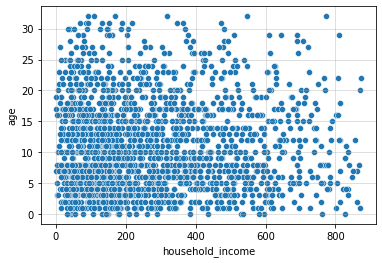

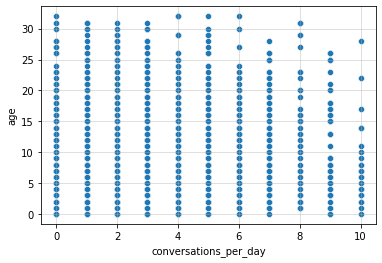

...

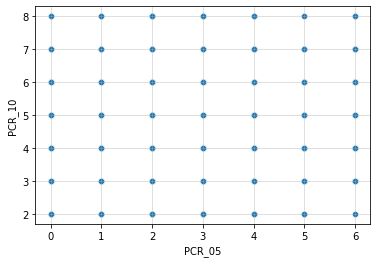

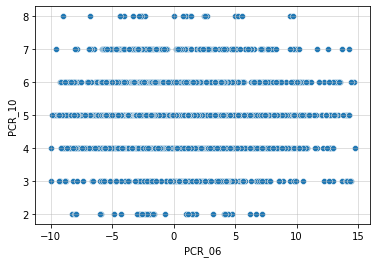

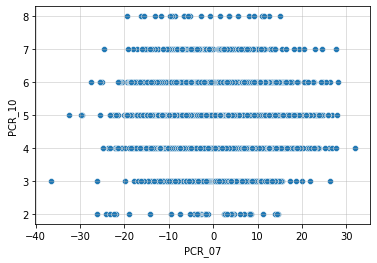

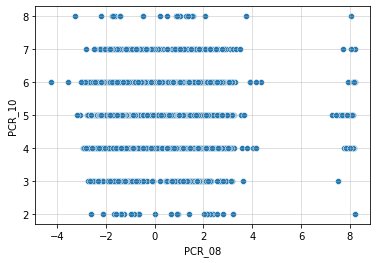

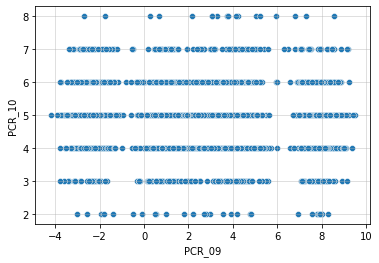

In [29]:
# Plotting scatter plots for every pair of numerical features for bivariate analysis


for i, y in enumerate(num_cols):
  for j, x in enumerate(num_cols):
    if x != y:
      plt.figure(figsize=(6, 4))
      plt.grid(alpha=0.5)
      sns.scatterplot(x=x, y=y, data=training_data)

In [30]:
training_data.corr()

,patient_id,age,weight,num_of_siblings,happiness_score,household_income,conversations_per_day,sugar_levels,sport_activity,PCR_01,PCR_02,PCR_03,PCR_04,PCR_05,PCR_06,PCR_07,PCR_08,PCR_09,PCR_10,covid,symptoms_cough,symptoms_fever,symptoms_headache,symptoms_low_appetite,symptoms_shortness_of_breath
patient_id,1.000000,0.021333,0.024436,-0.065241,-0.005352,0.042418,-0.021712,0.030500,-0.003517,0.032343,0.023056,-0.005107,0.005239,0.033861,0.022160,-0.006503,0.002865,0.020030,0.068337,-0.019215,-0.022898,-0.006056,0.006058,0.003958,-0.015047
age,0.021333,1.000000,0.777898,-0.007174,-0.004557,0.015711,-0.013473,0.433665,-0.158688,0.027735,0.035528,-0.000666,-0.026320,0.018869,-0.000572,-0.008986,0.035288,-0.048217,-0.000974,-0.034035,-0.041158,-0.002733,-0.035937,0.004151,-0.032196
weight,0.024436,0.777898,1.000000,-0.028409,-0.016578,0.030351,-0.001165,0.559380,-0.178707,0.011985,0.012754,-0.010958,-0.039186,0.006242,-0.002367,0.018449,0.038165,-0.020602,0.003954,-0.011691,-0.054520,0.043601,-0.052268,-0.009780,-0.030029
num_of_siblings,-0.065241,-0.007174,-0.028409,1.000000,-0.017812,-0.018823,0.005678,-0.022025,0.012904,-0.025912,-0.012405,-0.003801,0.026847,0.010286,-0.018161,-0.023749,0.031407,-0.011290,-0.005029,0.129545,-0.005628,-0.012135,-0.023173,0.040744,-0.002401
happiness_score,-0.005352,-0.004557,-0.016578,-0.017812,1.000000,-0.004212,-0.002032,0.016419,-0.014426,-0.019537,0.011846,0.041310,-0.042286,-0.006690,0.011269,0.008716,-0.022419,-0.014193,-0.022486,0.008171,-0.023653,0.015471,-0.018004,-0.007193,-0.014047
household_income,0.042418,0.015711,0.030351,-0.018823,-0.004212,1.000000,0.012463,0.005780,0.002445,0.005128,-0.005251,-0.047576,-0.000164,-0.012510,-0.009596,0.016045,-0.040824,0.015284,0.004041,-0.007923,0.032867,0.018011,0.036304,-0.002860,0.031205
conversations_per_day,-0.021712,-0.013473,-0.001165,0.005678,-0.002032,0.012463,1.000000,0.005718,0.018116,-0.004816,0.024723,-0.003878,0.020451,-0.001312,-0.019104,0.040654,0.003998,0.038715,0.005610,0.012312,-0.003988,0.019469,0.030088,-0.026280,-0.020750
sugar_levels,0.030500,0.433665,0.559380,-0.022025,0.016419,0.005780,0.005718,1.000000,-0.302253,0.034932,0.015359,0.000390,-0.017226,0.029101,0.000645,0.042987,0.003512,0.007490,0.012829,0.017417,-0.022088,-0.006744,-0.026418,0.001646,-0.002170
sport_activity,-0.003517,-0.158688,-0.178707,0.012904,-0.014426,0.002445,0.018116,-0.302253,1.000000,-0.011051,-0.003905,0.008287,-0.029428,0.026479,0.034343,-0.002313,0.004738,0.013100,0.016631,-0.027312,-0.017145,0.008392,0.041807,-0.022577,-0.044816
PCR_01,0.032343,0.027735,0.011985,-0.025912,-0.019537,0.005128,-0.004816,0.034932,-0.011051,1.000000,-0.002607,-0.025148,-0.005473,0.015759,0.003941,0.031035,-0.012913,0.021167,0.006759,-0.003416,0.000451,0.026134,0.006232,0.002568,-0.010918


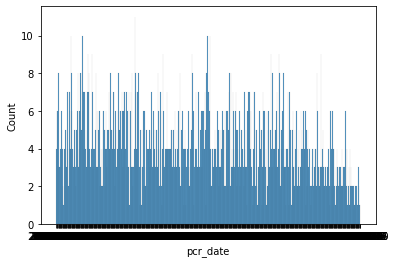

In [31]:
sns.histplot(training_data, x=training_data.pcr_date)

#### Box Plots for Bivariate Analysis

In [32]:
limited_cat_cols = ['conversations_per_day','num_of_siblings','happiness_score','sex','symptoms_cough','symptoms_headache',\
                    'symptoms_low_appetite','symptoms_shortness_of_breath','symptoms_fever','sport_activity','risk','spread',\
                    'covid','blood_type','age_groups','weight_groups','h_income_groups','sugar_levels_groups','PCR_01_groups'\
                    ,'PCR_02_groups','PCR_03_groups','PCR_04_groups','PCR_06_groups','PCR_07_groups','PCR_08_groups','PCR_09_groups'\
                    ,'PCR_05','PCR_10','address_states']                   
# Binning continuous and ordinal features with excessive numbers of categories for use in the box plots
training_data['age_groups'] = pd.cut(training_data.age, bins=[0,1,12,19,60,150], labels=['infant', 'child', 'teenager', 'adult', 'senior citizen'])
training_data['weight_groups'] = pd.cut(training_data.weight, np.arange(0, 136, 5))
training_data['h_income_groups'] = pd.cut(training_data.household_income, bins=[0,80,178,555,595,793,400_000_000], \
                                            labels=['poverty level', 'low income', 'middle class', 'upper middle class', 'high income', 'highest tax brackets'])
training_data['sugar_levels_groups'] = pd.cut(training_data.sugar_levels, bins=8)
training_data['PCR_01_groups'] = pd.cut(training_data.PCR_01, bins=8)
training_data['PCR_02_groups'] = pd.cut(training_data.PCR_02, bins=8)
training_data['PCR_03_groups'] = pd.cut(training_data.PCR_03, bins=8)
training_data['PCR_04_groups'] = pd.cut(training_data.PCR_04, bins=8)
training_data['PCR_06_groups'] = pd.cut(training_data.PCR_06, bins=8)
training_data['PCR_07_groups'] = pd.cut(training_data.PCR_07, bins=8)
training_data['PCR_08_groups'] = pd.cut(training_data.PCR_08, bins=8)
training_data['PCR_09_groups'] = pd.cut(training_data.PCR_09, bins=8)

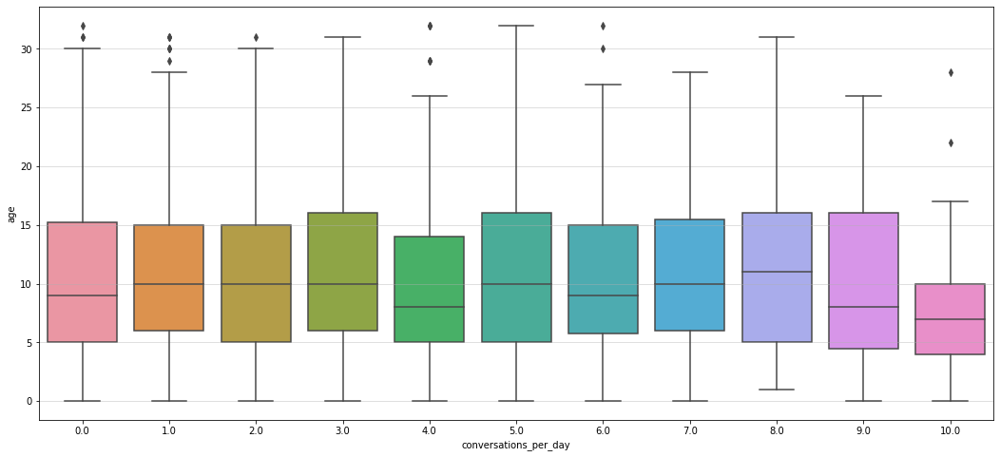

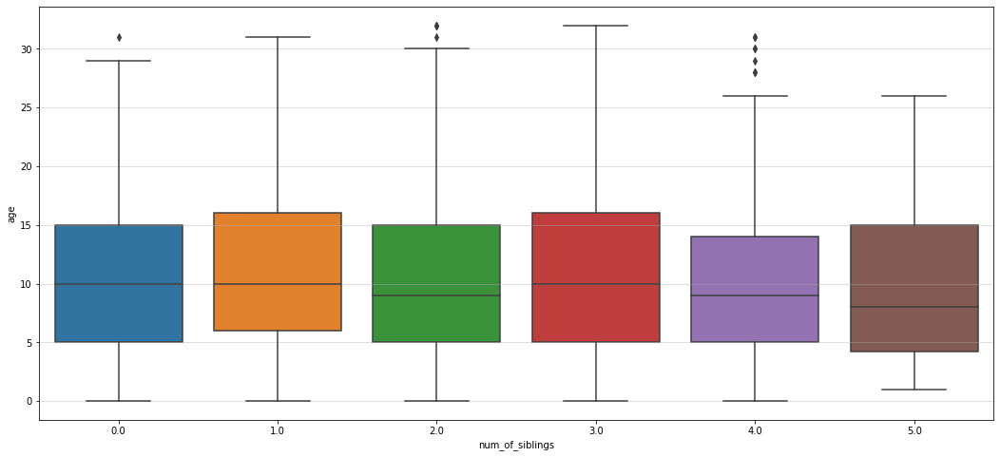

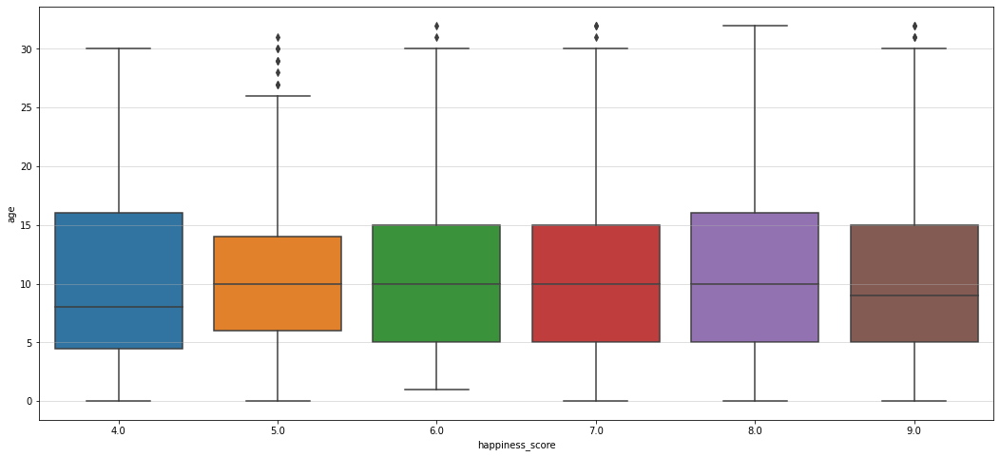

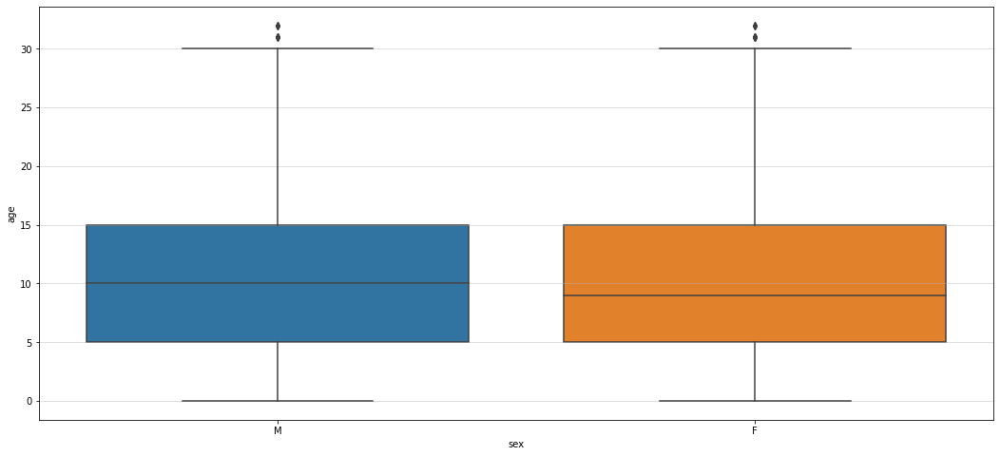

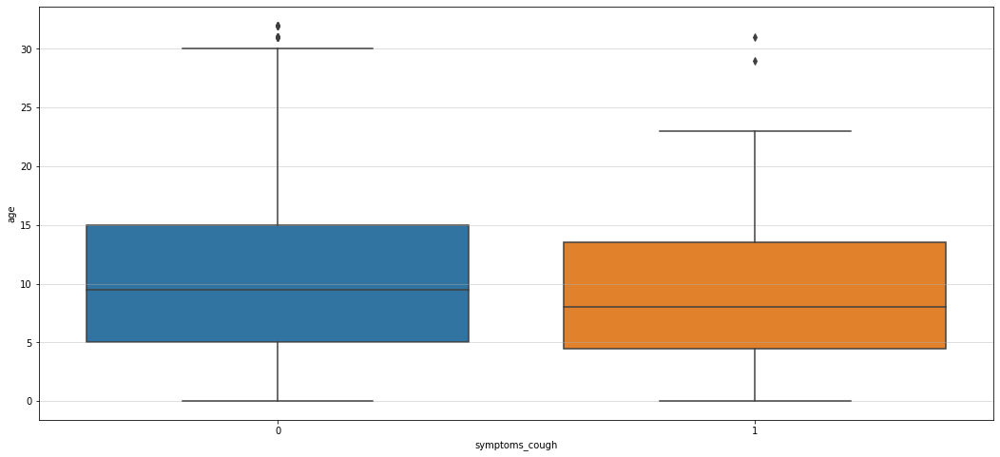

...

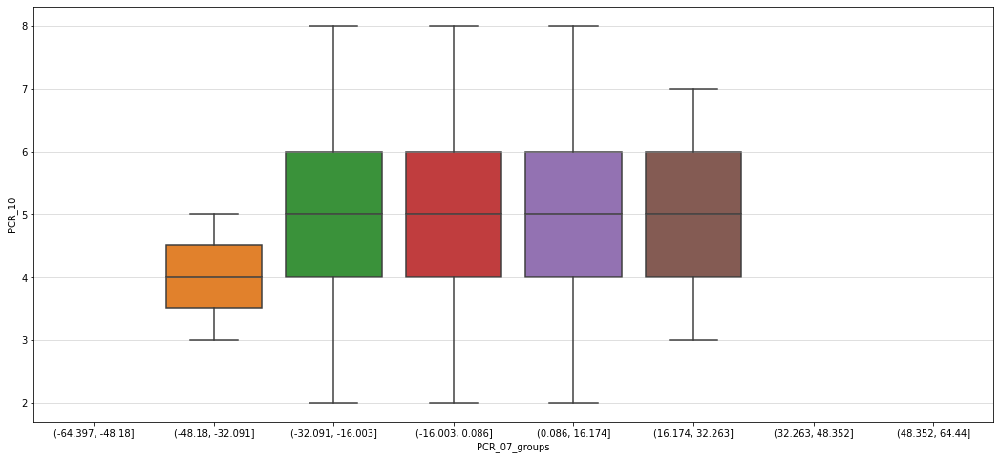

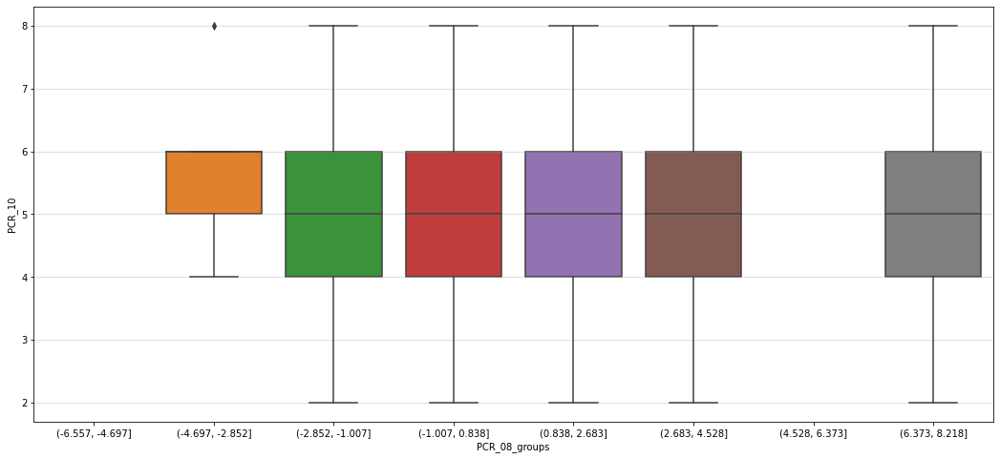

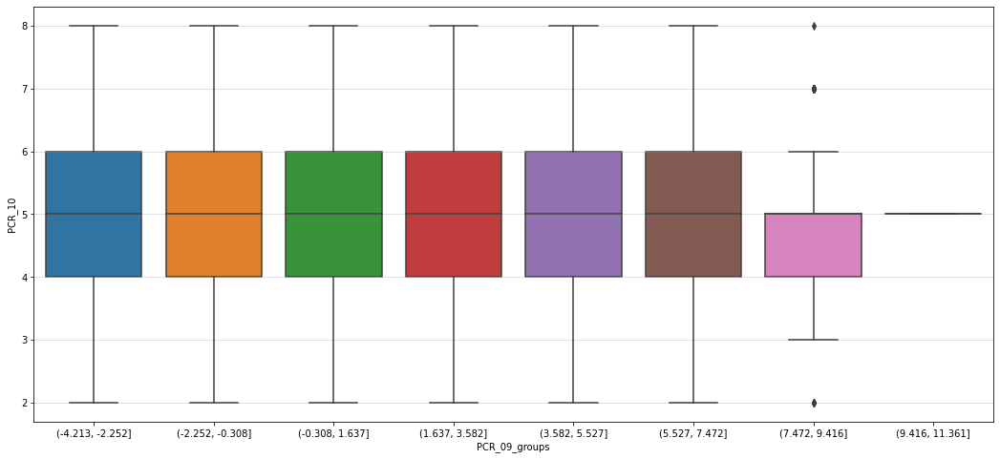

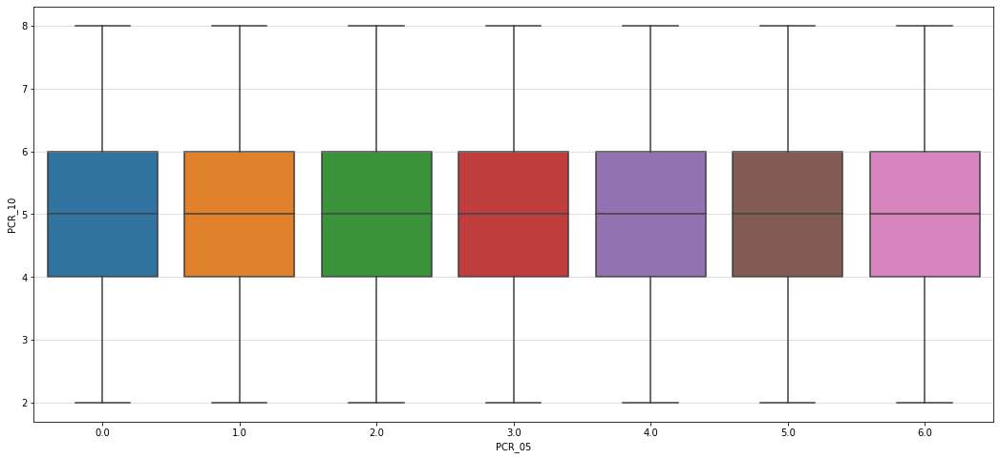

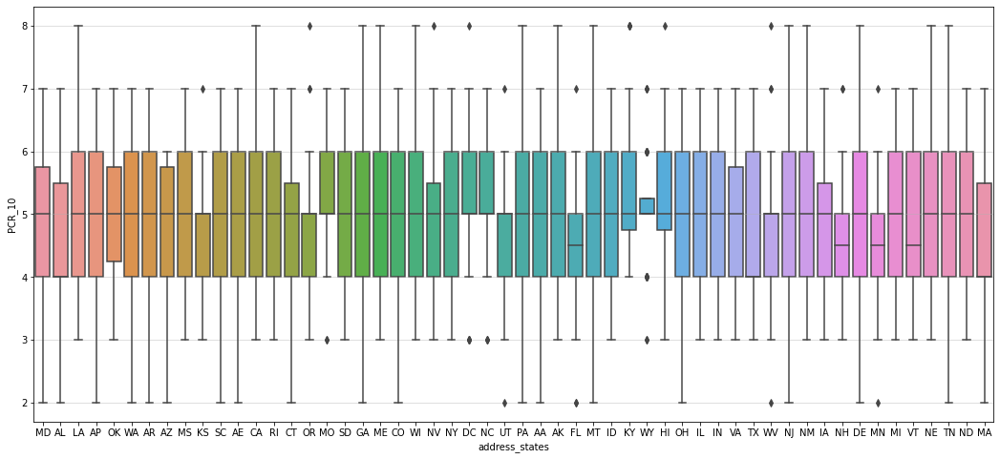

In [33]:
# Print the bivariate box plots
for i, y in enumerate(num_cols):
  for j, x in enumerate(limited_cat_cols):
    if x != y:
      plt.figure(figsize=(18, 8))
      plt.grid(alpha=0.5)
      sns.boxplot(x=x, y=y, data=training_data)

#### Cleaning Contextual Outliers

In [34]:

# Contextual outlier cleaning for PCR features
training_data['PCR_01'] = np.where(training_data['PCR_01'] >= 1.5, np.nan,\
  np.where(training_data['PCR_01'] <= -1.5, np.nan, training_data['PCR_01']))
training_data['PCR_02'] = np.where(training_data['PCR_02'] >= 1.5, np.nan,\
  np.where(training_data['PCR_02'] <= -1.5, np.nan, training_data['PCR_02']))
training_data['PCR_04'] = np.where(training_data['PCR_04'] >= 400, np.nan, \
   training_data['PCR_04'])
training_data['PCR_06'] = np.where(training_data['PCR_06'] <= -11, np.nan, \
   training_data['PCR_06'])
training_data['PCR_07'] = np.where(training_data['PCR_07'] >= 40, np.nan,\
  np.where(training_data['PCR_07'] <= -40, np.nan, training_data['PCR_07']))
training_data['PCR_08'] = np.where(training_data['PCR_04'] <= -5, np.nan, \
   training_data['PCR_08'])
training_data['PCR_09'] = np.where(training_data['PCR_09'] > 10, np.nan, \
   training_data['PCR_09'])
print(training_data.isna().sum())

# Contextual outlier cleaning for non-PCR features
pcr_cols = ['PCR_01','PCR_02','PCR_03','PCR_04','PCR_05','PCR_06','PCR_07','PCR_08','PCR_09','PCR_10']
for y_feat in [x for x in num_cols if x not in pcr_cols]:
  for x_feat in limited_cat_cols:
    if y_feat == x_feat: continue
    cats = training_data[x_feat].dropna().unique()
    num_cats = len(cats)
    if num_cats == 0: continue
    outlier_sum = 0
    for cat in cats:
      sub_col = training_data[training_data[x_feat] == cat]
      min, max = skewed_boundaries(sub_col[y_feat])
      outlier_sum += (sub_col[(sub_col[y_feat] >= max) | (sub_col[y_feat] <= min)].shape[0])
      #print(f'{y_feat} : {x_feat} : {cat} : min is {min}, max is {max}, outlier sum is {outlier_sum}\n')
    outlier_num_mean = floor(outlier_sum / num_cats)
    #print(f'{y_feat} : {x_feat} : outlier mean is {outlier_num_mean}\n')
    for cat in training_data[x_feat].unique():
      sub_col = training_data.loc[training_data[x_feat] == cat, :]
      min, max = skewed_boundaries(sub_col[y_feat])
      if sub_col[(sub_col[y_feat] >= max) | (sub_col[y_feat] <= min)].shape[0] <= outlier_num_mean:
        training_data.loc[training_data[x_feat] == cat, y_feat] = outliers_set_nan_iqr(sub_col[y_feat])
print(training_data.isna().sum())

patient_id                        0
age                             199
sex                               0
weight                          143
blood_type                        0
num_of_siblings                 161
happiness_score                 149
household_income                205
pcr_date                        119
conversations_per_day           175
sugar_levels                    156
sport_activity                  173
PCR_01                          176
PCR_02                          182
PCR_03                          171
PCR_04                          189
PCR_05                          262
PCR_06                          208
PCR_07                          190
PCR_08                          584
PCR_09                          453
PCR_10                          212
risk                              0
spread                            0
covid                             0
symptoms_cough                    0
symptoms_fever                    0
symptoms_headache           

In [35]:
# Remove temporary group features from training set
training_data.drop(columns=['age_groups', 'weight_groups', 'h_income_groups', 'sugar_levels_groups', 'PCR_01_groups', 'PCR_02_groups', 'PCR_03_groups'\
                    , 'PCR_04_groups', 'PCR_06_groups', 'PCR_07_groups', 'PCR_08_groups', 'PCR_09_groups'], inplace=True)

### Perform OHE on Specific Features

In [36]:
# Replace categorical features with OHE features in training set:
training_data = pd.concat([training_data, ohe_sex, ohe_blood_type, df_address_states], axis='columns')
training_data.drop(['sex', 'blood_type','address_states'], axis=1, inplace=True)

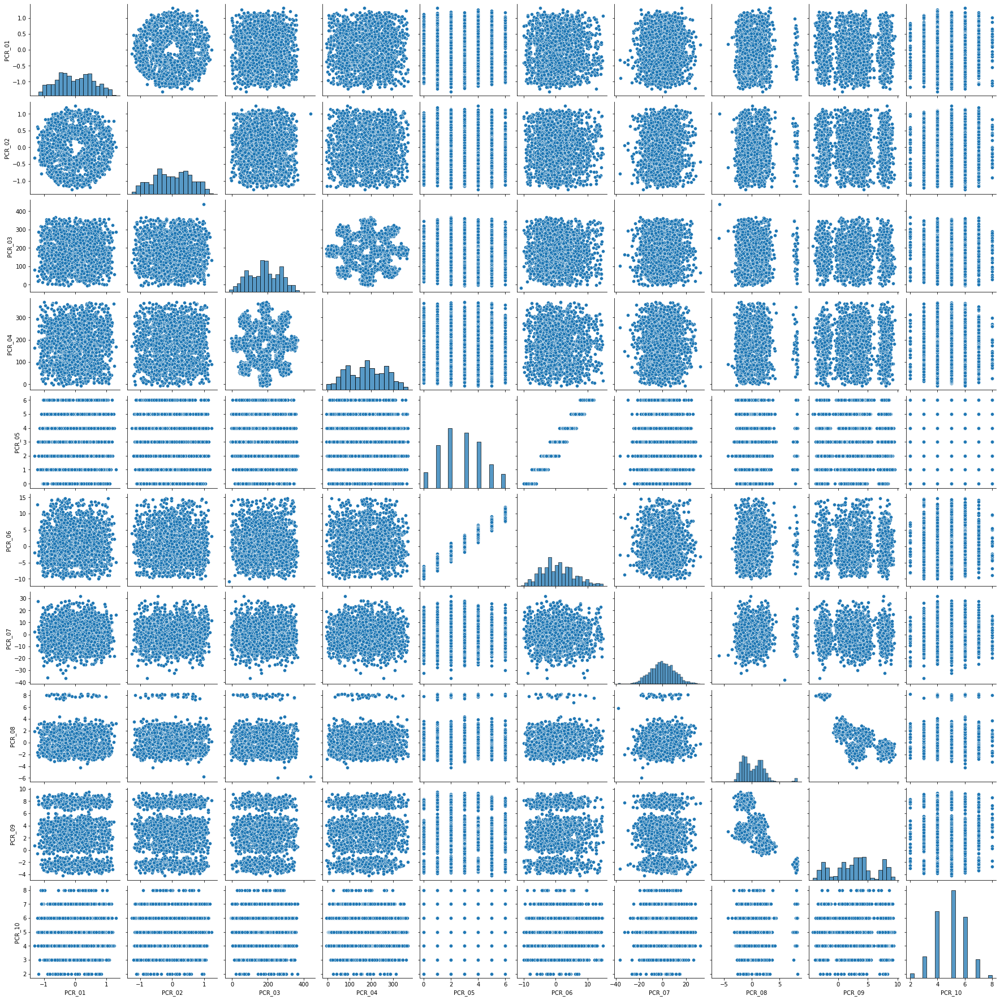

In [37]:
pcr_cols = ['PCR_01','PCR_02','PCR_03','PCR_04','PCR_05','PCR_06','PCR_07','PCR_08','PCR_09','PCR_10']
all_cols_without_pcr = [x for x in training_data.columns if x not in pcr_cols]
sns.pairplot(training_data, y_vars=pcr_cols, x_vars=pcr_cols)

##Q16:

In [38]:
# First of all, count the precentage of the missing num_of_sibilings data
nan_precentage = training_data["num_of_siblings"].isna().sum() / training_data.shape[0]
print (f'{100 * nan_precentage }% of num_of_sibilings column in our train dataset is NaN' )

# We received an approximate 5% so we'll go with median imputation technique
imputer = SimpleImputer(missing_values=np.nan, strategy='median')

# Fit the imputer to the train data
imputer.fit(training_data['num_of_siblings'].values.reshape(-1,1))

# Apply the transformation to the train data
training_data['num_of_siblings'] = imputer.transform(training_data['num_of_siblings'].values.reshape(-1,1))

6.708333333333333% of num_of_sibilings column in our train dataset is NaN


## Q17:

In [39]:
def show_sex_and_weight():
  plt.figure()
  plt.grid(alpha=0.5)
  sns.boxplot(y='weight', data=training_data)

  temp_col=np.where(training_data['sex_M'] == 1, 'M','F')
  plt.figure()
  plt.grid(alpha=0.5)
  sns.histplot(x=temp_col )

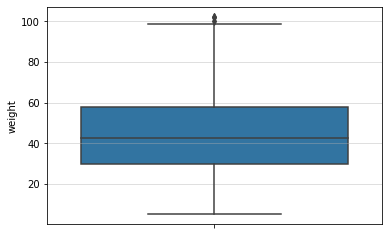

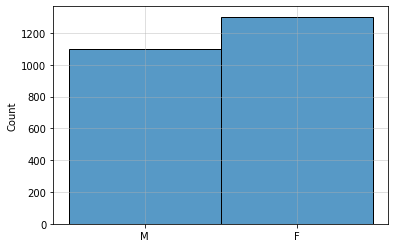

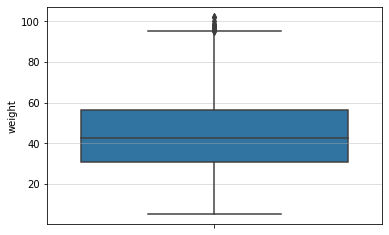

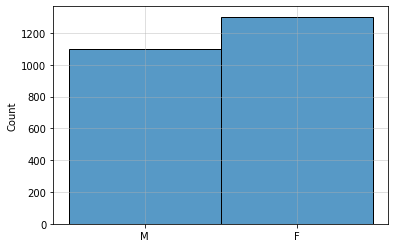

In [40]:
median_imp_cols=['weight','household_income']
random_imp_cols=['happiness_score','conversations_per_day','PCR_06','PCR_02','PCR_03','PCR_04','PCR_01','PCR_09','PCR_07','PCR_10','sport_activity']
should_be_deleted_cause_corr=['sugar_levels','age','PCR_05','PCR_08','pcr_date']

# As requested 
show_sex_and_weight()

imputer = SimpleImputer(missing_values=np.nan, strategy='median')
for col in median_imp_cols: 
  imputer.fit(training_data[col].values.reshape(-1,1))
  training_data[col] = imputer.transform(training_data[col].values.reshape(-1,1))

for col in random_imp_cols: 
  training_data[col] = impute_by_random(training_data,col).values

show_sex_and_weight()

## Q19:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1743: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)


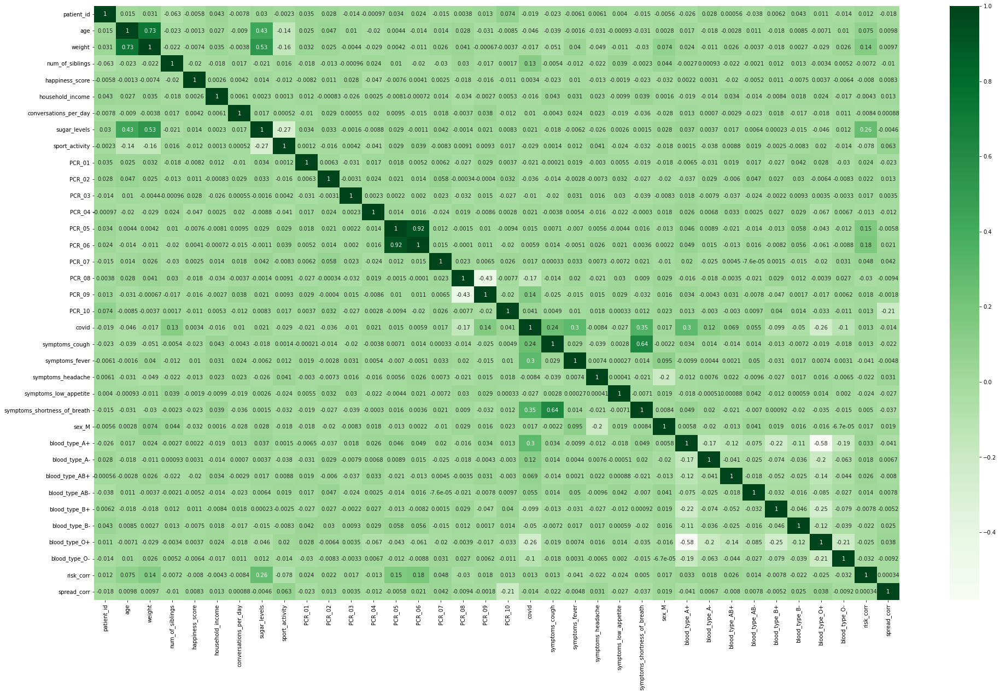

In [41]:
# Produce correlation matrix for training data minus state features

plt.figure(figsize=(33,20))
temp = training_data[training_data.columns.drop(list(training_data.filter(regex='address')))]
temp.loc[:,'risk_corr'] = np.where(training_data['risk'] == 'High', 1, 0)
temp.loc[:,'spread_corr'] = np.where(training_data['spread'] == 'High', 1, 0)
corr_matrix = sns.heatmap(temp.corr(), cmap="Greens", annot=True)

## Q21:

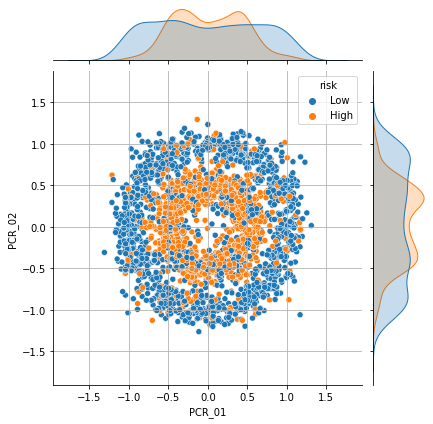

In [42]:
g = sns.jointplot(data=training_data, x="PCR_01", y="PCR_02",hue="risk")
_ = g.ax_joint.grid()

Q22:

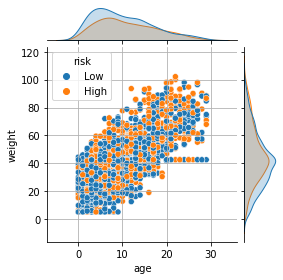

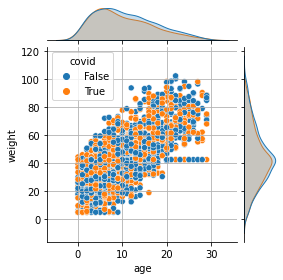

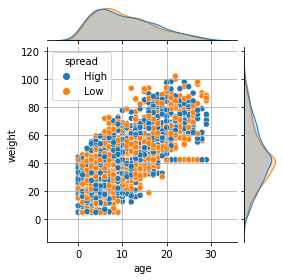

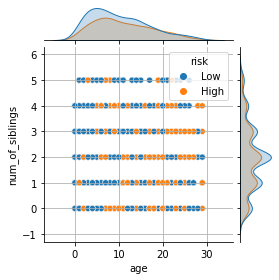

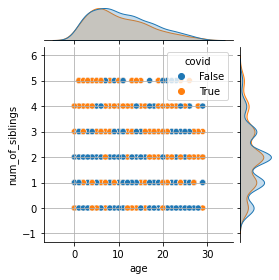

...

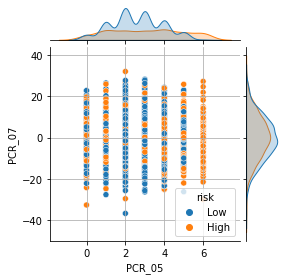

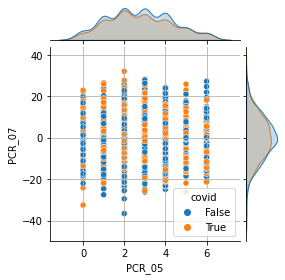

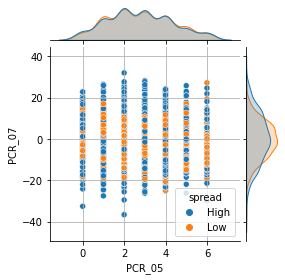

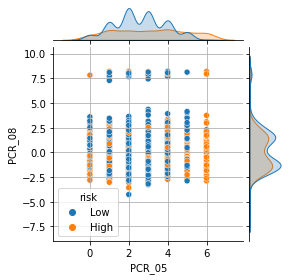

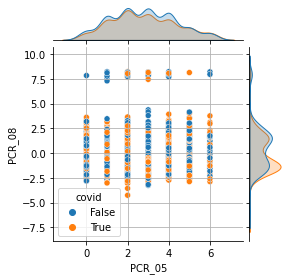

In [ ]:
for i,col_X in enumerate(num_cols):
  for j,col_Y in enumerate(num_cols):
    if(i<j):
      g = sns.jointplot(data=training_data, x=col_X, y=col_Y, hue="risk", height=4)
      _ = g.ax_joint.grid()
      g = sns.jointplot(data=training_data, x=col_X, y=col_Y, hue="covid", height=4)
      _ = g.ax_joint.grid()
      g = sns.jointplot(data=training_data, x=col_X, y=col_Y, hue="spread", height=4)
      _ = g.ax_joint.grid()

In [ ]:
potential_separables=[
                     ('PCR_01','PCR_03','spread'),\
                     ('num_of_siblings','PCR_10','spread'),\
                     ('PCR_01','PCR_02','risk'),\
                     ('PCR_01','PCR_06','risk')]
                     
for params in potential_separables:
  g = sns.jointplot(data=training_data, x=params[0], y=params[1], hue=params[2])
  _ = g.ax_joint.grid()

In [ ]:
# Add blood_A_AB feature to data set

training_data['blood_A_AB'] = np.where((training_data['blood_type_A+'] == 1) | (training_data['blood_type_A-'] == 1) \
                                       | (training_data['blood_type_AB+'] == 1) | (training_data['blood_type_AB-'] == 1), 1, 0)

In [ ]:


# Drop features from the data sert that we decided not to keep

to_keep = ['num_of_siblings', 'PCR_01', 'PCR_02', 'PCR_03', 'PCR_06', 'PCR_10', 'blood_A_AB', 'risk', 'spread', 'covid']
to_drop = [x for x in training_data.columns if x not in to_keep]
training_data.drop(to_drop, axis='columns', inplace=True)



# How to download from Colab?

In [ ]:
from google.colab import files
outputPath = "out.xlsx"
corr_matrix.to_excel(outputPath)
files.download(outputPath) 